# HHA550_Diabetes Prediction Dataset

## Healtcare-dataset-diabetes-data
# Context 
The dataset represents ten years (1999-2008) of clinical care at 130 US hospitals and integrated delivery networks. Each row concerns hospital records of patients diagnosed with diabetes, who underwent laboratory, medications, and stayed up to 14 days. The goal is to determine the early readmission of the patient within 30 days of discharge. The problem is important for the following reasons. Despite high-quality evidence showing improved clinical outcomes for diabetic patients who receive various preventive and therapeutic interventions, many patients do not receive them. This can be partially attributed to arbitrary diabetes management in hospital environments, which fail to attend to glycemic control. Failure to provide proper diabetes care not only increases the managing costs for the hospitals (as the patients are readmitted) but also impacts the morbidity and mortality of the patients, who may face complications associated with diabetes.


# importing everything

In [140]:
# Commands to install some of the libraries in-case if they are not installed
# Any other library that needs to be installed just use: !pip install <library name>

!pip install seaborn
!pip install missingno
!pip install xgboost
!pip install catboost
!pip install regex
!pip install sklearn
!pip install pandas
!pip install numpy
!pip install imblearn
!pip install lightgbm    
!pip install ucimlrepo


  Using cached sklearn-0.0.post12.tar.gz (2.6 kB)
  Preparing metadata (setup.py) ... error
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> [15 lines of output]
      The 'sklearn' PyPI package is deprecated, use 'scikit-learn'
      rather than 'sklearn' for pip commands.
      
      Here is how to fix this error in the main use cases:
      - use 'pip install scikit-learn' rather than 'pip install sklearn'
      - replace 'sklearn' by 'scikit-learn' in your pip requirements files
        (requirements.txt, setup.py, setup.cfg, Pipfile, etc ...)
      - if the 'sklearn' package is used by one of your dependencies,
        it would be great if you take some time to track which package uses
        'sklearn' instead of 'scikit-learn' and report it to their issue tracker
      - as a last resort, set the environment variable
        SKLEARN_ALLOW_DEPRECATED_SKLEARN_PACKAGE_INSTALL=True to avoid this error
      
    

In [141]:
from ucimlrepo import fetch_ucirepo, list_available_datasets
import pandas as pd   # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np   # linear algebra
import matplotlib.pyplot as plt  #graphs and plots
import seaborn as sns   #data visualizations 
import csv # Some extra functionalities for csv  files - reading it as a dictionary
from lightgbm import LGBMClassifier #sklearn is for machine learning and statistical modeling including classification, regression, clustering and dimensionality reduction 

from sklearn.model_selection import train_test_split, cross_validate   #break up dataset into train and test sets

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler


# importing python library for working with missing data
import missingno as msno
# To install missingno use: !pip install missingno
import re    # This library is used to perform regex pattern matching

# import various functions from sklearn
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, classification_report, make_scorer
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split



In [142]:
from sklearn.model_selection import KFold,cross_val_score, RepeatedStratifiedKFold,StratifiedKFold
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import OneHotEncoder,StandardScaler,PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer,SimpleImputer
from sklearn.compose import make_column_transformer
from imblearn.pipeline import make_pipeline
from sklearn.svm import SVC
from sklearn.impute import SimpleImputer
from sklearn.dummy import DummyClassifier
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, balanced_accuracy_score, precision_score, recall_score, roc_auc_score, classification_report, f1_score

import plotly 
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
from ucimlrepo import fetch_ucirepo
import warnings
warnings.filterwarnings("ignore")

# Start with Loading the CSV Data

In [144]:
diabetes = pd.read_csv('/Users/angelazhang/Documents/pythonProjects/diabetes+130-us+hospitals+for+years+1999-2008/diabetic_data.csv')


# Looking at the Data

In [146]:
diabetes.head()


,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,2278392,8222157,Caucasian,Female,[0-10),?,6,25,1,1,...,No,No,No,No,No,No,No,No,No,NO
1,149190,55629189,Caucasian,Female,[10-20),?,1,1,7,3,...,No,Up,No,No,No,No,No,Ch,Yes,>30
2,64410,86047875,AfricanAmerican,Female,[20-30),?,1,1,7,2,...,No,No,No,No,No,No,No,No,Yes,NO
3,500364,82442376,Caucasian,Male,[30-40),?,1,1,7,2,...,No,Up,No,No,No,No,No,Ch,Yes,NO
4,16680,42519267,Caucasian,Male,[40-50),?,1,1,7,1,...,No,Steady,No,No,No,No,No,Ch,Yes,NO


## insights into our target variable

In [148]:
y = diabetes['readmitted']
readmitted_percentage = round(y.value_counts(normalize=True)[1] * 100, 2)
not_readmitted_percentage = round(y.value_counts(normalize=True)[0] * 100, 2)
readmitted_count = y.value_counts()[1]
not_readmitted_count = y.value_counts()[0]

print(f'Percentage of patients who were readmitted: {readmitted_percentage}% --> ({readmitted_count} patients)')
print(f'Percentage of patients who were not readmitted: {not_readmitted_percentage}% --> ({not_readmitted_count} patients)')


Percentage of patients who were readmitted: 34.93% --> (35545 patients)
Percentage of patients who were not readmitted: 53.91% --> (54864 patients)


### So what does that all mean?
We have imbalanced data

* Almost 53.91% of the instances of our target variable were not `readmitted`
* 54864 patients were not readmitted to the hospital after staying at the hospital for 14 days
* 34.93% of the instances of our target variable were `readmitted`
* 35545 patients were readmitted to the hospital after staying at the hospital for 14 days

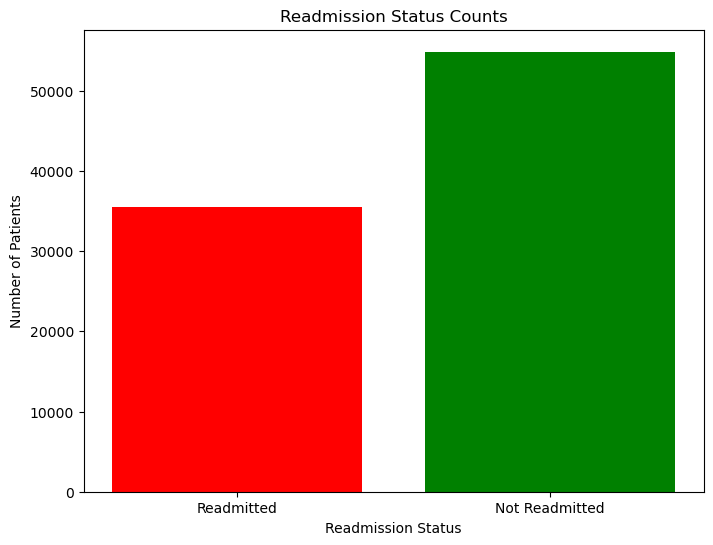

In [150]:
import matplotlib.pyplot as plt

# Calculate the counts of readmitted and not-readmitted patients
readmitted_count = y.value_counts()[1]
not_readmitted_count = y.value_counts()[0]

# Prepare the data for the bar chart
data = [readmitted_count, not_readmitted_count]
labels = ['Readmitted', 'Not Readmitted']

# Plot the bar chart
plt.figure(figsize=(8, 6))
plt.bar(labels, data, color=['red', 'green'])

# Add labels and title
plt.xlabel('Readmission Status')
plt.ylabel('Number of Patients')
plt.title('Readmission Status Counts')
plt.show()


## Checking for missing value/data

In [152]:
def missing (diabetes):
    missing_number = diabetes.isnull().sum().sort_values(ascending=False)
    missing_percent = (diabetes.isnull().sum()/diabetes.isnull().count()).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
    return missing_values

missing(diabetes)

,Missing_Number,Missing_Percent
max_glu_serum,96420,0.947468
A1Cresult,84748,0.832773
encounter_id,0,0.000000
nateglinide,0,0.000000
glimepiride,0,0.000000
acetohexamide,0,0.000000
glipizide,0,0.000000
glyburide,0,0.000000
tolbutamide,0,0.000000
pioglitazone,0,0.000000


In [153]:
# Removing the unnecessary columns  to simplify the dataset
columns_to_drop = ['encounter_id', 'patient_nbr', 'payer_code']
diabetes = diabetes.drop([col for col in columns_to_drop if col in diabetes.columns], axis=1)
diabetes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 47 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   race                      101766 non-null  object
 1   gender                    101766 non-null  object
 2   age                       101766 non-null  object
 3   weight                    101766 non-null  object
 4   admission_type_id         101766 non-null  int64 
 5   discharge_disposition_id  101766 non-null  int64 
 6   admission_source_id       101766 non-null  int64 
 7   time_in_hospital          101766 non-null  int64 
 8   medical_specialty         101766 non-null  object
 9   num_lab_procedures        101766 non-null  int64 
 10  num_procedures            101766 non-null  int64 
 11  num_medications           101766 non-null  int64 
 12  number_outpatient         101766 non-null  int64 
 13  number_emergency          101766 non-null  int64 
 14  numb

<Axes: >

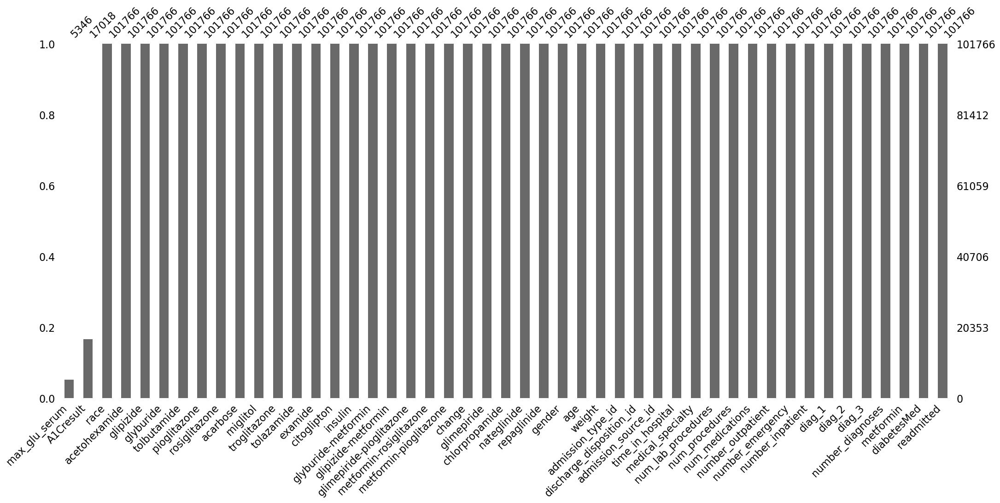

In [154]:
msno.bar(diabetes, sort="ascending")

<Axes: >

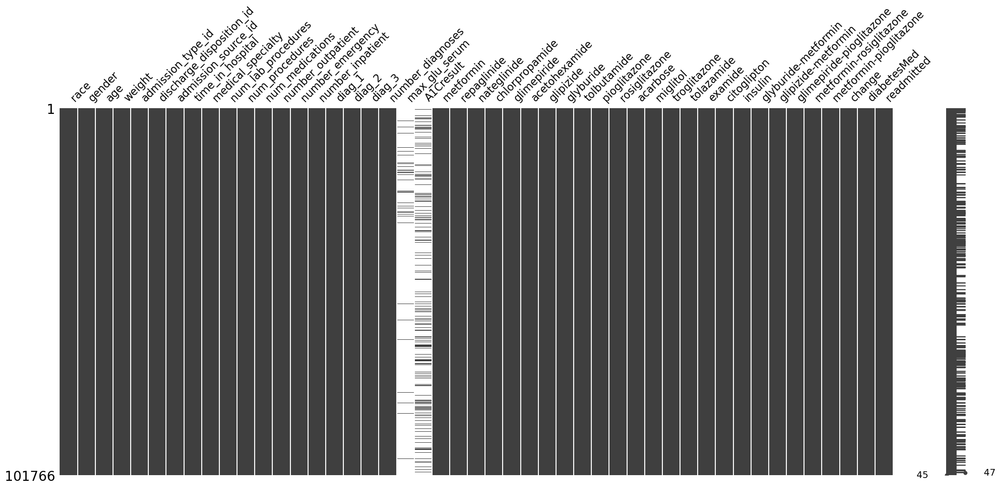

In [155]:
msno.matrix(diabetes)

In [156]:
# Get the columns that have any ? or 'Unknown/Invalid' in them
diabetes.columns[diabetes.isin(['?', 'Unknown/Invalid']).any()].tolist()
# Replace them with NaN, allowing them to be recognized as missing values
diabetes.replace(['?', 'Unknown/Invalid'], np.nan, inplace = True)
diabetes.head()

,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,medical_specialty,num_lab_procedures,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,Caucasian,Female,[0-10),NaN,6,25,1,1,Pediatrics-Endocrinology,41,...,No,No,No,No,No,No,No,No,No,NO
1,Caucasian,Female,[10-20),NaN,1,1,7,3,NaN,59,...,No,Up,No,No,No,No,No,Ch,Yes,>30
2,AfricanAmerican,Female,[20-30),NaN,1,1,7,2,NaN,11,...,No,No,No,No,No,No,No,No,Yes,NO
3,Caucasian,Male,[30-40),NaN,1,1,7,2,NaN,44,...,No,Up,No,No,No,No,No,Ch,Yes,NO
4,Caucasian,Male,[40-50),NaN,1,1,7,1,NaN,51,...,No,Steady,No,No,No,No,No,Ch,Yes,NO


In [157]:
# Naming numerical variables

numerical = ['admission_type_id', 'discharge_disposition_id', 'admission_source_id', 'time_in_hospital','num_lab_procedures','num_procedures', 'num_medications',
              'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses', 'max_glu_serum', 'A1Cresult' ]

# Naming categorical variables
categorical = ['age' , 'weight' , 'race', 'gender', 'payer_code', 'medical_specialty', 'metformin', 'repaglinide', 'nateglinide', 'chlorpropamide',
               'glimepiride', 'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide', 'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol',
               'troglitazone', 'tolazamide', 'examide', 'citoglipton', 'insulin', 'glyburide-metformin','glipizide-metformin', 'glimepiride-pioglitazone',
               'metformin-rosiglitazone', 'metformin-pioglitazon', 'change', 'diabetesMed']

In [158]:
diabetes[numerical].describe()

,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
count,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000
mean,2.024006,3.715642,5.754437,4.395987,43.095641,1.339730,16.021844,0.369357,0.197836,0.635566,7.422607
std,1.445403,5.280166,4.064081,2.985108,19.674362,1.705807,8.127566,1.267265,0.930472,1.262863,1.933600
min,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
25%,1.000000,1.000000,1.000000,2.000000,31.000000,0.000000,10.000000,0.000000,0.000000,0.000000,6.000000
50%,1.000000,1.000000,7.000000,4.000000,44.000000,1.000000,15.000000,0.000000,0.000000,0.000000,8.000000
75%,3.000000,4.000000,7.000000,6.000000,57.000000,2.000000,20.000000,0.000000,0.000000,1.000000,9.000000
max,8.000000,28.000000,25.000000,14.000000,132.000000,6.000000,81.000000,42.000000,76.000000,21.000000,16.000000


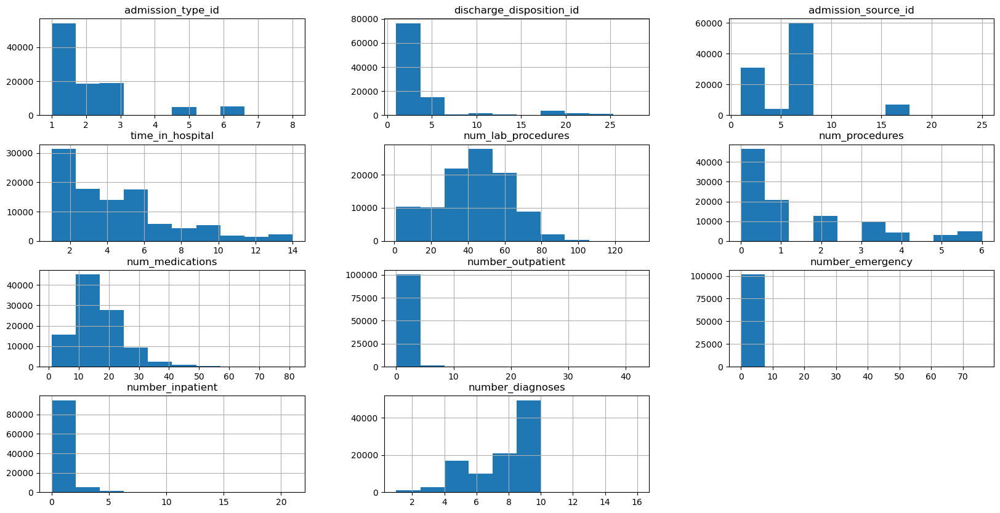

In [159]:
diabetes[numerical].hist(figsize=(20,10));

# Univariate Analysis

In [161]:
print (f'{round(diabetes["age"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="age", title='Age', width=500, height=500, color_discrete_sequence=['orange'])
fig.show()

age
[70-80)     25.62
[60-70)     22.09
[50-60)     16.96
[80-90)     16.90
[40-50)      9.52
[30-40)      3.71
[90-100)     2.74
[20-30)      1.63
[10-20)      0.68
[0-10)       0.16
Name: proportion, dtype: float64


In [162]:
print (f'{round(diabetes["gender"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="gender", title='Gender', width=500, height=500)
fig.show()

gender
Female    53.76
Male      46.24
Name: proportion, dtype: float64


In [163]:
print (f'{round(diabetes["race"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="race", title='Race', width=500, height=500, color_discrete_sequence=['green'])
fig.show()

race
Caucasian          76.49
AfricanAmerican    19.31
Hispanic            2.05
Other               1.51
Asian               0.64
Name: proportion, dtype: float64


In [164]:
print (f'{round(diabetes["weight"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="weight", title='Weight', width=500, height=500, color_discrete_sequence=['red'])
fig.show()

weight
[75-100)     41.79
[50-75)      28.06
[100-125)    19.55
[125-150)     4.54
[25-50)       3.03
[0-25)        1.50
[150-175)     1.09
[175-200)     0.34
>200          0.09
Name: proportion, dtype: float64


In [165]:
print (f'{round(diabetes["number_diagnoses"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="number_diagnoses", title='Number_diagnoses', width=500, height=500, color_discrete_sequence=['purple'])
fig.show()

number_diagnoses
9     48.62
5     11.20
8     10.43
7     10.21
6      9.98
4      5.44
3      2.79
2      1.01
1      0.22
16     0.04
10     0.02
13     0.02
11     0.01
15     0.01
12     0.01
14     0.01
Name: proportion, dtype: float64


# Bivariate Analysis

In [167]:
fig = px.histogram(diabetes, x="gender", color="diabetesMed",width=600, height=400)
fig.show()

In [169]:
fig = px.histogram(diabetes, x="age", color="readmitted", width=600, height=400,
                   category_orders={"age": sorted(diabetes["age"].unique())})  # Ascending order by default
fig.show()


In [170]:
fig = px.histogram(diabetes, x="readmitted", color="diabetesMed", width=600, height=400)
fig.show()# Assuming 'diabetes' is your dataframe


## Correlation Matrix & Scatter Plots

In [172]:
#diabetes[numerical].corr()

## Converting Categorical Features into Numeric Features

In [174]:
# Using get_dummies from the pandas library to convert categorical to numeric
diabetes = pd.get_dummies(diabetes, drop_first = False)
diabetes.head()


,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,...,metformin-rosiglitazone_Steady,metformin-pioglitazone_No,metformin-pioglitazone_Steady,change_Ch,change_No,diabetesMed_No,diabetesMed_Yes,readmitted_<30,readmitted_>30,readmitted_NO
0,6,25,1,1,41,0,1,0,0,0,...,False,True,False,False,True,True,False,False,False,True
1,1,1,7,3,59,0,18,0,0,0,...,False,True,False,True,False,False,True,False,True,False
2,1,1,7,2,11,5,13,2,0,1,...,False,True,False,False,True,False,True,False,False,True
3,1,1,7,2,44,1,16,0,0,0,...,False,True,False,True,False,False,True,False,False,True
4,1,1,7,1,51,0,8,0,0,0,...,False,True,False,True,False,False,True,False,False,True


In [175]:
# Break up data into training (70%), validation (15%), and test data (15%)
train_df, valid_df, test_df = np.split(diabetes.sample(frac=1, random_state=42), 
                                        [int(.7*len(diabetes)), int(0.85*len(diabetes))])
train_df = train_df.reset_index(drop=True)
valid_df = valid_df.reset_index(drop=True)
test_df = test_df.reset_index(drop=True)


In [176]:
print(diabetes['readmitted_<30'].value_counts())  # For the column readmitted_<30
print(diabetes['readmitted_>30'].value_counts())  # For the column readmitted_>30
print(diabetes['readmitted_NO'].value_counts())   # For the column readmitted_NO



readmitted_<30
False    90409
True     11357
Name: count, dtype: int64
readmitted_>30
False    66221
True     35545
Name: count, dtype: int64
readmitted_NO
True     54864
False    46902
Name: count, dtype: int64


In [177]:

print(train_df['readmitted_<30'].value_counts())  # For readmitted_<30
print(train_df['readmitted_>30'].value_counts())  # For readmitted_>30
print(train_df['readmitted_NO'].value_counts())   # For readmitted_NO


readmitted_<30
False    63275
True      7961
Name: count, dtype: int64
readmitted_>30
False    46318
True     24918
Name: count, dtype: int64
readmitted_NO
True     38357
False    32879
Name: count, dtype: int64


In [178]:
print(valid_df['readmitted_<30'].value_counts())  # For readmitted_<30
print(valid_df['readmitted_>30'].value_counts())  # For readmitted_>30
print(valid_df['readmitted_NO'].value_counts())   # For readmitted_NO


readmitted_<30
False    13520
True      1745
Name: count, dtype: int64
readmitted_>30
False    10008
True      5257
Name: count, dtype: int64
readmitted_NO
True     8263
False    7002
Name: count, dtype: int64


In [179]:
print(test_df['readmitted_<30'].value_counts())  # For readmitted_<30
print(test_df['readmitted_>30'].value_counts())  # For readmitted_>30
print(test_df['readmitted_NO'].value_counts())   # For readmitted_NO


readmitted_<30
False    13614
True      1651
Name: count, dtype: int64
readmitted_>30
False    9895
True     5370
Name: count, dtype: int64
readmitted_NO
True     8244
False    7021
Name: count, dtype: int64


In [180]:
train_score = model.score(X_train, y_train)
test_score = model.score(X_test, y_test)

print(f"Training Score: {train_score}")
print(f"Test Score: {test_score}")

NameError: name 'model' is not defined

## Treating the Imbalance in the Data

Imbalance in the data means that one of the classes in the data is too less as compared to the others. Typically, it is better to balance the data in some way to give the positives more weight. There are 3 strategies that are typically utilized:

* Sub-sample the more dominant class: use a random subset of the negatives
* Over-sample the imbalanced class: use the same positive samples multiple times
* Create synthetic positive data

Usually, you will want to use the latter two methods if you only have a handful of positive cases. Since we have a few thousand positive cases, let's use the sub-sample approach. Here, we will create a balanced training data set that has 50% positive and 50% negative. You can also play with this ratio to see if you can get an improvement.

In [ ]:
def calc_prevalence(y_actual):
    
    '''
    This function is to understand the ratio/distribution of the classes that we are going to predict for.
    
    Params:
    1. y_actual: The target feature
    
    Return:
    1. (sum(y_actual)/len(y_actual)): The ratio of the postive class in the comlpete data.
    '''
    
    return (sum(y_actual)/len(y_actual))

In [ ]:
# Split the training data into positive and negative (for readmitted_<30)
rows_pos = train_df['readmitted_<30'] == 1  # Positive cases: readmitted within <30 days
df_train_pos = train_df.loc[rows_pos]  # Positive cases
df_train_neg = train_df.loc[~rows_pos]  # Negative cases: not readmitted within <30 days

# Merge the balanced data: resample the negative class to match the positive class
readmitted_df_balanced = pd.concat([df_train_pos, df_train_neg.sample(n = len(df_train_pos), random_state = 111)], axis = 0)

# Shuffle the order of training samples
readmitted_df_balanced = readmitted_df_balanced.sample(n = len(readmitted_df_balanced), random_state = 42).reset_index(drop = True)

# Print the balanced data prevalence
print('Train balanced prevalence(n = %d): %.3f' % (len(readmitted_df_balanced), 
                                                 calc_prevalence(readmitted_df_balanced['readmitted_<30'].values)))



In [ ]:
# down-sampling method aka sub-samble
readmitted_df_balanced['readmitted_<30'].value_counts()



In [ ]:
# Now, create the features and target for training, validation, and testing
X_train = readmitted_df_balanced.drop('readmitted_<30', axis=1)  # Features for training
y_train = readmitted_df_balanced['readmitted_<30']  # Target for training

# Assuming valid_df and test_df are predefined:
X_valid = valid_df.drop('readmitted_<30', axis=1)  # Features for validation
y_valid = valid_df['readmitted_<30']  # Target for validation

X_test = test_df.drop('readmitted_<30', axis=1)  # Features for testing
y_test = test_df['readmitted_<30']  # Target for testing


In [ ]:
# scaling is only for numerical values to make it close to 0 and 1s
numerical = [
    "admission_type_id", "discharge_disposition_id", "admission_source_id", "time_in_hospital", 
    "num_lab_procedures", "num_procedures", "num_medications", "number_outpatient", 
    "number_emergency", "number_inpatient", "number_diagnoses"
]
scaler=StandardScaler()
X_train[numerical] = pd.DataFrame(scaler.fit_transform(X_train[numerical]),columns=numerical)
X_valid[numerical] = pd.DataFrame(scaler.transform(X_valid[numerical]),columns=numerical)
X_test[numerical] = pd.DataFrame(scaler.transform(X_test[numerical]),columns=numerical)

In [ ]:
X_train.head(10)

## Creating and Understanding Models

In [ ]:
def calc_specificity(y_actual, y_pred, thresh):
    # calculates specificity
    return sum((y_pred < thresh) & (y_actual == 0)) /sum(y_actual ==0)

def print_report(y_actual, y_pred, thresh = 0.5):
    
    '''
    This function calculates all the metrics to asses the machine learning models.
    
    Params:
    1. y_actual: The actual values for the target variable.
    2. y_pred: The predicted values for the target variable.
    3. thresh: The threshold for the probability to be considered as a positive class. Default value 0.5
    
    Return:
    1. AUC
    2. Accuracy
    3. Recall
    4. Precision
    5. Specificity
    '''
    
    auc = roc_auc_score(y_actual, y_pred)
    accuracy = accuracy_score(y_actual, (y_pred > thresh))
    recall = recall_score(y_actual, (y_pred > thresh))
    precision = precision_score(y_actual, (y_pred > thresh))
    specificity = calc_specificity(y_actual, y_pred, thresh)
    print('AUC:%.3f'%auc)
    print('accuracy:%.3f'%accuracy)
    print('recall:%.3f'%recall)
    print('precision:%.3f'%precision)
    print('specificity:%.3f'%specificity)
    print('prevalence:%.3f'%calc_prevalence(y_actual))
    print(' ')
    return auc, accuracy, recall, precision, specificity

# Linear Regression
* Linear Regression: used to predict numerical variables(continuous variables)
* Logistic Regression: used to predict categorical variables

In [ ]:
lnr = LinearRegression()
lnr.fit(X_train, y_train)


y_valid_preds = lnr.predict(X_valid)

In [ ]:
y_valid_preds|

In [ ]:
plt.scatter(X_valid, y_valid, color='blue', label='Actual Data')
plt.plot(X_valid, y_valid_preds, color='red', linewidth=2, label='Regression Line')
plt.xlabel('Number of Medications')
plt.ylabel('Time in Hospital')
plt.title('Linear Regression: Time in Hospital vs Number of Medications')
plt.legend()
plt.show()

## Logistic Regression

In [ ]:
#Logistic Regression (for sub-sampling dominant class)
lr=LogisticRegression(random_state = 42, solver = 'newton-cg', max_iter = 200)
lr.fit(X_train, y_train)

y_valid_preds = lr.predict_proba(X_valid)[:,1]

print('Metrics for Validation data:')

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,y_valid_preds, 0.5)

In [ ]:
print(set(y_valid))


## Decision Tree Analysis

In [ ]:
dc_clf = DecisionTreeClassifier(random_state=42, max_depth = 10)
dc_clf.fit(X_train, y_train)

dc_preds_proba = dc_clf.predict_proba(X_valid)[:,1]
dc_preds = dc_clf.predict(X_valid)

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,dc_preds_proba, 0.5)

## KIN MODEL

In [ ]:
knn = KNeighborsClassifier(n_neighbors = 100)
knn.fit(X_train, y_train)

knn_preds = knn.predict_proba(X_valid)[:,1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,knn_preds, 0.5)


## Stochastic Gradient Descent Model

In [ ]:
sgdc=SGDClassifier(loss = 'log',alpha = 0.1,random_state = 42)
sgdc.fit(X_train, y_train)

sgd_preds = sgdc.predict_proba(X_valid)[:,1]

print('Stochastic Gradient Descent')
print('Validation:')
sgdc_valid_auc, sgdc_valid_accuracy, sgdc_valid_recall, \
                sgdc_valid_precision, sgdc_valid_specificity = print_report(y_valid,sgd_preds, 0.5)

## Random Forest

In [ ]:
rf_clf = RandomForestClassifier(random_state=111, max_depth = 6)

rf_clf.fit(X_train, y_train)

rf_preds = rf_clf.predict(X_valid)
rf_preds_proba = rf_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,rf_preds_proba, 0.5)

## Linear SVC

In [ ]:
lsvc_clf = LinearSVC(random_state=111)
lsvc_clf.fit(X_train, y_train)

lsvc_preds = lsvc_clf.decision_function(X_valid)

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,lsvc_preds, 0.5)

## Gradient Boosting Model

In [ ]:
gb_clf = GradientBoostingClassifier(n_estimators = 100, criterion='friedman_mse', learning_rate = 1.0, max_depth = 3,\
                                    random_state = 111)

gb_clf.fit(X_train, y_train)
gb_preds = gb_clf.predict(X_valid)
gb_preds_proba = gb_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,gb_preds_proba, 0.5)

## XGB Model

In [ ]:
xgb_clf = xgb.XGBClassifier(max_depth=3, learning_rate = 1.0, use_label_encoder = False,\
                            eval_metric = 'logloss')
xgb_clf.fit(X_train, y_train)

xgb_preds = xgb_clf.predict(X_valid)
xgb_preds_proba = xgb_clf.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,xgb_preds_proba, 0.5)

## Catboost Model

In [ ]:
catb=CatBoostClassifier(iterations=200, depth=3, learning_rate=1.0, random_state = 111)
catb.fit(X_train, y_train)
catb_preds = catb.predict_proba(X_valid)[:, 1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,catb_preds, 0.5)

## Decision Tree - Hyper Parameter Tuning

In [ ]:
recall_scoring = make_scorer(recall_score)
dc_grid = {'max_features':['auto','sqrt'], # maximum number of features to use at each split
           'max_depth':range(1,11,1), # maximum depth of the tree
           'min_samples_split':range(2,10,2), # minimum number of samples to split a node
           'criterion':['gini','entropy']} # criterion for evaluating a split

dc_random = RandomizedSearchCV(estimator = dc_clf, param_distributions = dc_grid, 
                               n_iter = 20, cv = 2, scoring=recall_scoring,
                               verbose = 1, random_state = 111)

dc_random.fit(X_train, y_train)

dc_random.best_params_

dc_hp_preds = dc_random.best_estimator_.predict(X_valid)
dc_hp_preds_proba = dc_random.best_estimator_.predict_proba(X_valid)[:,1]
roc_auc_score(y_valid, dc_hp_preds_proba)